# **Exploratory Data Analysis**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Importing Necessary Libraries**

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

import plotly as pt
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import calendar
import plotly.express as px
import plotly.figure_factory as ff

from pylab import *

import plotly.graph_objects as go
import nltk
from nltk.corpus import stopwords
#!pip install geoplot
#import geopandas as gpd
#import geoplot
#from geopy.geocoders import Nominatim
import folium

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/DSCI-550-Group-Project/Data/cleaned_data.csv")

Please note we have some missing values in data - it should not be a problem while performing EDA
You can always refer the preprocessing data.ipynb file for reference.
I have a made a new dataset which you can load - cleaner version with the name "cleaned_data.csv"
Also in the last of that notebook i have also done some EDA (very less), feel free to look.


In [ ]:
print("Size of our Dataset:", df.shape)

Size of our Dataset: (2666559, 39)


In [ ]:
pd.set_option('display.max_columns', None)
df.head(5)

,Severity,Start_Lat,Start_Lng,Street,Side,City,County,State,Zipcode,Airport_Code,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Sunrise_Sunset_Night,Civil_Twilight_Night,Nautical_Twilight_Night,Astronomical_Twilight_Night,year,month,Weekday,Hour
0,3,40.108910,-83.092860,Outerbelt E,R,Dublin,Franklin,OH,43017,KOSU,42.1,36.1,58.0,29.76,10.0,SW,10.4,0.00,Rain,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,2016,2,0,0
1,2,39.865420,-84.062800,I-70 E,R,Dayton,Montgomery,OH,45424,KFFO,36.9,63.0,91.0,29.68,10.0,Calm,7.0,0.02,Rain,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,2016,2,0,5
2,2,39.102660,-84.524680,I-75 S,R,Cincinnati,Hamilton,OH,45203,KLUK,36.0,63.0,97.0,29.70,10.0,Calm,7.0,0.02,Cloudy,0,0,0,0,1,0,0,0,0,0,0,0,1,1,1,0,2016,2,0,6
3,2,41.062130,-81.537840,I-77 N,R,Akron,Summit,OH,44311,KAKR,39.0,63.0,55.0,29.65,10.0,Calm,7.0,0.00,Cloudy,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,2016,2,0,6
4,3,39.172393,-84.492792,I-75 S,R,Cincinnati,Hamilton,OH,45217,KLUK,37.0,29.8,93.0,29.69,10.0,SW,10.4,0.01,Rain,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2016,2,0,7


In [ ]:
df.describe()

,Severity,Start_Lat,Start_Lng,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in),Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Sunrise_Sunset_Night,Civil_Twilight_Night,Nautical_Twilight_Night,Astronomical_Twilight_Night,year,month,Weekday,Hour
count,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06,2.666559e+06
mean,2.144931e+00,3.632266e+01,-9.730926e+01,6.177945e+01,6.010201e+01,6.442256e+01,2.948128e+01,9.131807e+00,7.374850e+00,5.668219e-03,9.526135e-03,3.528892e-04,6.849427e-02,2.434223e-03,1.048554e-01,1.488810e-03,8.039575e-03,4.612686e-05,2.222377e-02,1.746108e-02,5.891488e-04,9.367953e-02,3.634868e-01,3.223270e-01,2.751482e-01,2.353846e-01,2.019933e+03,7.455377e+00,2.752912e+00,1.277304e+01
std,4.895176e-01,5.313801e+00,1.828782e+01,1.843267e+01,1.937090e+01,2.262339e+01,1.032327e+00,2.686724e+00,5.371647e+00,8.602202e-02,9.713594e-02,1.878204e-02,2.525922e-01,4.927777e-02,3.063670e-01,3.855638e-02,8.930254e-02,6.791521e-03,1.474106e-01,1.309817e-01,2.426524e-02,2.913824e-01,4.810034e-01,4.673675e-01,4.465890e-01,4.242391e-01,1.458789e+00,3.636598e+00,1.867569e+00,5.859341e+00
min,1.000000e+00,2.456603e+01,-1.245481e+02,-8.900000e+01,-8.900000e+01,1.000000e+00,2.000000e-02,6.000000e-02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.016000e+03,1.000000e+00,0.000000e+00,0.000000e+00
25%,2.000000e+00,3.350124e+01,-1.180566e+02,5.000000e+01,5.100000e+01,4.900000e+01,2.933000e+01,1.000000e+01,4.600000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.019000e+03,4.000000e+00,1.000000e+00,8.000000e+00
50%,2.000000e+00,3.614130e+01,-9.300367e+01,6.400000e+01,6.300000e+01,6.700000e+01,2.982000e+01,1.000000e+01,7.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.021000e+03,8.000000e+00,3.000000e+00,1.400000e+01
75%,2.000000e+00,4.017183e+01,-8.041242e+01,7.590000e+01,7.300000e+01,8.300000e+01,3.001000e+01,1.000000e+01,1.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,2.021000e+03,1.100000e+01,4.000000e+00,1.700000e+01
max,4.000000e+00,4.900058e+01,-6.711317e+01,1.960000e+02,1.960000e+02,1.000000e+02,5.890000e+01,1.400000e+02,1.087000e+03,2.400000e+01,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,2.021000e+03,1.200000e+01,6.000000e+00,2.300000e+01


In [ ]:
df.columns

Index(['Severity', 'Start_Lat', 'Start_Lng', 'Street', 'Side', 'City',
       'County', 'State', 'Zipcode', 'Airport_Code', 'Temperature(F)',
       'Wind_Chill(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)',
       'Wind_Direction', 'Wind_Speed(mph)', 'Precipitation(in)',
       'Weather_Condition', 'Amenity', 'Bump', 'Crossing', 'Give_Way',
       'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 'Stop',
       'Traffic_Calming', 'Traffic_Signal', 'Sunrise_Sunset_Night',
       'Civil_Twilight_Night', 'Nautical_Twilight_Night',
       'Astronomical_Twilight_Night', 'year', 'month', 'Weekday', 'Hour'],
      dtype='object')

#### **Number of Accidents per state**

In [ ]:
state_counts = df["State"].value_counts()
states = pd.DataFrame(state_counts).reset_index()
states.rename(columns={'index': 'state_code', 'State': 'cases' }, inplace=True)
states = states.sort_values(by='cases', ascending=False)
us_states = {
    'AL': 'Alabama', 'AK': 'Alaska', 'AZ': 'Arizona', 'AR': 'Arkansas', 'CA': 'California',
    'CO': 'Colorado', 'CT': 'Connecticut', 'DE': 'Delaware', 'FL': 'Florida', 'GA': 'Georgia',
    'HI': 'Hawaii', 'ID': 'Idaho', 'IL': 'Illinois', 'IN': 'Indiana', 'IA': 'Iowa', 'KS': 'Kansas',
    'KY': 'Kentucky', 'LA': 'Louisiana', 'ME': 'Maine', 'MD': 'Maryland', 'MA': 'Massachusetts',
    'MI': 'Michigan', 'MN': 'Minnesota', 'MS': 'Mississippi', 'MO': 'Missouri', 'MT': 'Montana',
    'NE': 'Nebraska', 'NV': 'Nevada', 'NH': 'New Hampshire', 'NJ': 'New Jersey', 'NM': 'New Mexico',
    'NY': 'New York', 'NC': 'North Carolina', 'ND': 'North Dakota', 'OH': 'Ohio', 'OK': 'Oklahoma',
    'OR': 'Oregon', 'PA': 'Pennsylvania', 'RI': 'Rhode Island', 'SC': 'South Carolina',
    'SD': 'South Dakota', 'TN': 'Tennessee', 'TX': 'Texas', 'UT': 'Utah', 'VT': 'Vermont',
    'VA': 'Virginia', 'WA': 'Washington', 'WV': 'West Virginia', 'WI': 'Wisconsin', 'WY': 'Wyoming'
}

states['state'] = states['state_code'].map(us_states)
states.head(10)


,state_code,cases,state
0,CA,748987,California
1,FL,356001,Florida
2,TX,142816,Texas
3,OR,120848,Oregon
4,VA,108245,Virginia
5,NY,96983,New York
6,MN,92192,Minnesota
7,PA,91182,Pennsylvania
8,SC,86112,South Carolina
9,NC,84890,North Carolina


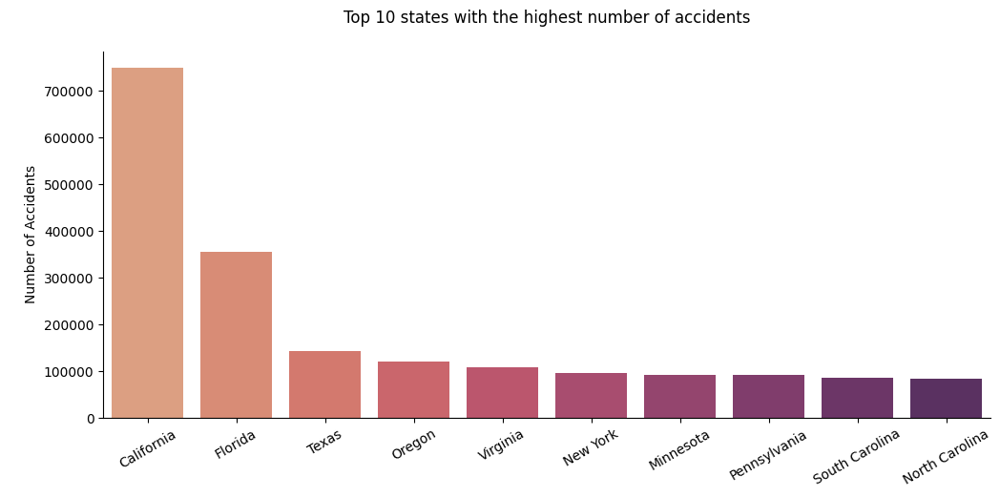

In [ ]:
fig, ax = plt.subplots(figsize = (12,5))
top_10 = states[:10]

sns.barplot(x=top_10['state'], y=top_10['cases'], palette='flare')

plt.title("Top 10 states with the highest number of accidents\n")
plt.ylabel("\nNumber of Accidents")
plt.xticks(rotation=30)
plt.xlabel(None)

total_accidents = df.shape[0]

sns.set(rc={'xtick.labelsize': 12, 'ytick.labelsize': 12})
def format_func(value, _):
    return f'{value:.0f}'
ax.yaxis.set_major_formatter(FuncFormatter(format_func))

for i in ['top', 'right']:
    ax.spines[i].set_color('white')
    ax.spines[i].set_linewidth(1.5)

plt.show()

In [ ]:
state_counts = df["State"].value_counts()
fig = go.Figure(data=go.Choropleth(locations=state_counts.index, z=state_counts.values.astype(float), locationmode="USA-states"))
fig.update_layout(title_text="Number of Accidents per State", geo_scope="usa")
fig.show()

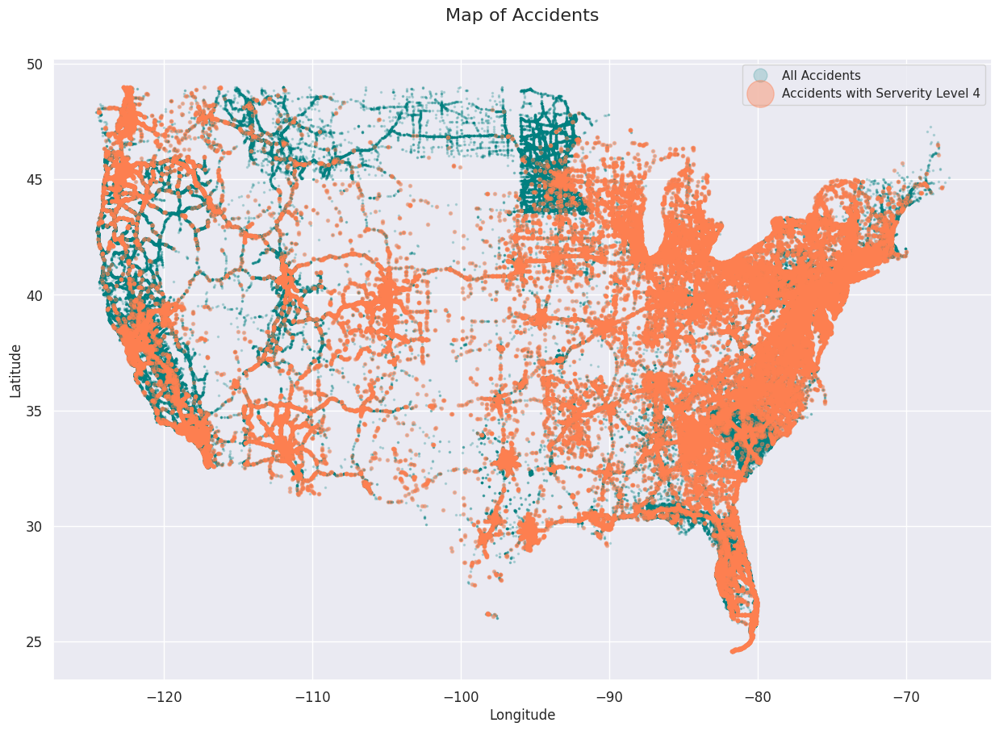

In [ ]:
df_4 = df[df['Severity']==4]

plt.figure(figsize=(15,10))

plt.plot( 'Start_Lng', 'Start_Lat', data=df, linestyle='', marker='o', markersize=1.5, color="teal", alpha=0.2, label='All Accidents')
plt.plot( 'Start_Lng', 'Start_Lat', data=df_4, linestyle='', marker='o', markersize=3, color="coral", alpha=0.4, label='Accidents with Serverity Level 4')
plt.legend(markerscale=8)
plt.xlabel('Longitude', size=12, labelpad=3)
plt.ylabel('Latitude', size=12, labelpad=3)
plt.title('Map of Accidents', size=16, y=1.05)
plt.show()

**Key Discovery:** California has highest no of accident cases followed by Florida and Texas.

#### **Cities with most no of accidents**

In [ ]:
cities = pd.DataFrame(df["City"].value_counts()).reset_index()
cities = cities.rename(columns={'index':'City','City':'cases'})
cities.sort_values(by='cases',ascending=False)
cities.head(10)

,City,cases
0,Miami,89245
1,Los Angeles,65120
2,Orlando,45531
3,Dallas,40314
4,Houston,37232
5,Charlotte,30353
6,Sacramento,30207
7,San Diego,24978
8,Minneapolis,21992
9,Raleigh,21288


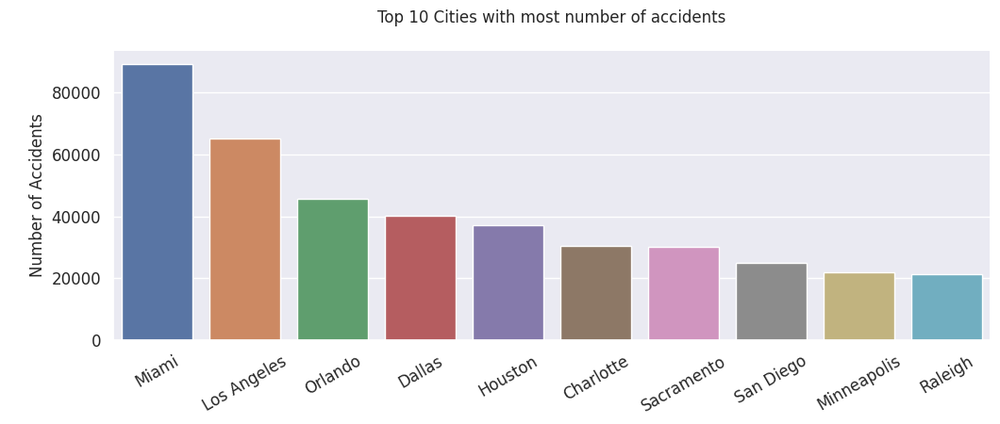

In [ ]:
fig, ax = plt.subplots(figsize = (12,4))
sns.set_style('ticks')

sns.barplot(x=cities[:10].City, y=cities[:10].cases)
plt.title("Top 10 Cities with most number of accidents\n")
plt.ylabel("\nNumber of Accidents")
plt.xlabel(None)
plt.xticks(rotation=30)

sns.set(rc={'xtick.labelsize': 12, 'ytick.labelsize': 12})

def format_func(value, _):
    return f'{value:.0f}'  # Format as whole numbers
ax.yaxis.set_major_formatter(FuncFormatter(format_func))

for i in ['top', 'right']:
    ax.spines[i].set_color('white')
    ax.spines[i].set_linewidth(1.5)

plt.show()

**Key Discovery:** Miami city has highest no of recorded accidents followed by Loa Angeles and Orlando.

##### **Exploring Miami City and Los Angeles City Accidents**

In [ ]:
# FLORIDA
fl_lat = 25.76
fl_long = -80.19

fl_map = folium.Map(location=[fl_lat, fl_long], zoom_start=12)

In [ ]:
miami_data = df.loc[df['City'] == 'Miami']
miami_data = miami_data.iloc[0:3000, :]
accidents = folium.map.FeatureGroup()

for lat, lng, in zip(miami_data.Start_Lat.dropna(),
                     miami_data.Start_Lng.dropna()):
    accidents.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=5, # define how big you want the circle markers to be
            color='Green',
            fill=True,
            fill_color='Red',
            fill_opacity=0.2
        )
    )

# add incidents to map
fl_map.add_child(accidents)

In [ ]:
from folium import plugins

# let's start again with a clean copy of the map of San Francisco
fl_map = folium.Map(location=[fl_lat, fl_long], zoom_start=12)

# instantiate a mark cluster object for the incidents in the dataframe
accidents = plugins.MarkerCluster().add_to(fl_map)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng, label in zip(miami_data.Start_Lat.dropna(),
                           miami_data.Start_Lng.dropna(),
                           miami_data.Severity.dropna()):
     folium.Marker(
        location=[lat, lng],
        icon=None,
        popup=label,
    ).add_to(accidents)

# display map
fl_map

In [ ]:
LAMap = folium.Map(location = (34.0549, -118.2426))
losAngeles_Data = df[df['City'] == 'Los Angeles']
losAngeles_Data = losAngeles_Data.iloc[0:2000,:]

accidentsLA = folium.map.FeatureGroup()


for lat,lng in zip(losAngeles_Data.Start_Lat.dropna(),
                   losAngeles_Data.Start_Lng.dropna()):
  LAMap.add_child(folium.CircleMarker(
      [lat,lng],
      radius = 3
  ))
LAMap.add_child(accidentsLA)


In [ ]:
CAMAP_4 = folium.Map(location = (36.7783, -119.4179)) # 36.7783° N, 119.4179° W

In [ ]:
df_4 = df[df['Severity']==4]
df_4_CA = df_4[df_4['State'] == 'CA']

accidents_CA = folium.map.FeatureGroup()

for lat,lng in zip(df_4_CA.Start_Lat.dropna(),
                   df_4_CA.Start_Lng.dropna()):
  LAMap.add_child(folium.CircleMarker(
      [lat,lng],
      radius = 3
  ))
LAMap.add_child(accidentsLA)

####  **Impact of weather and road features on accidents**

In [ ]:
print("Total no. of Weather Conditions seen in the dataset:", len(df["Weather_Condition"].unique()))

print("\nWeather Condition counts:")
wc = pd.DataFrame(df['Weather_Condition'].value_counts()).reset_index()
wc.rename(columns={'index':'Weather', 'Weather_Condition':'count'}, inplace=True)
wc.sort_values(by='count', ascending=False)

Total no. of Weather Conditions seen in the dataset: 11

Weather Condition counts:


,Weather,count
0,Clear,1267159
1,Cloudy,1027611
2,Rain,176195
3,Fog,73587
4,Snow,54296
5,Windy,30719
6,Thunderstorm,29839
7,Smoke,6796
8,Sand,202
9,Hail,147


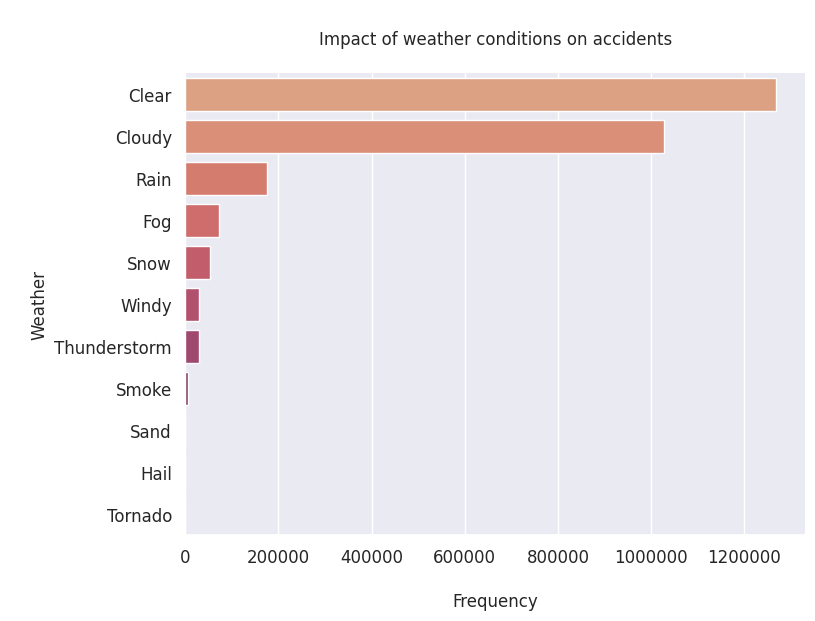

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6), facecolor='white')
sns.set_style('ticks')
sns.barplot(x='count', y='Weather', data=wc, palette='flare',orient='h')

ax.set_xlabel('\nFrequency')
ax.set_ylabel('\nWeather')
ax.set_title('\nImpact of weather conditions on accidents\n')
plt.xticks(rotation=0)

sns.set(rc={'xtick.labelsize': 10, 'ytick.labelsize': 10})
ax.set_xscale('linear')
for i in ['top', 'right']:
    ax.spines[i].set_visible(False)

def format_func(value, _):
    return f'{value:.0f}'  # Format as whole numbers
ax.xaxis.set_major_formatter(FuncFormatter(format_func))

plt.show()

**Key Discovery:** Majority of the accidents took place during clear day. This may also mean that no of vehicles on road is directly proportional to good weather condition.

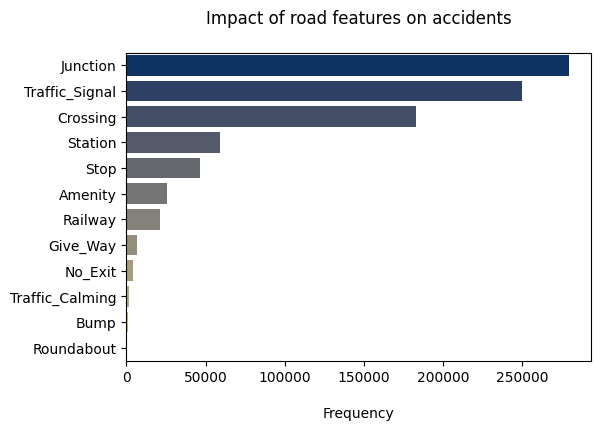

In [ ]:
road_features = ["Amenity", "Bump", "Crossing", "Give_Way", "Junction", "No_Exit", "Railway", "Roundabout", "Station", "Stop", "Traffic_Calming", "Traffic_Signal"]

data = df[road_features].sum().sort_values(ascending=False)

fig, ax = plt.subplots(figsize=(6, 4))
sns.barplot(x=data.values, y=data.index, orient="h", palette='cividis')
plt.title("Impact of road features on accidents\n")
plt.xlabel("\nFrequency")

plt.show()

**Key Discovery:** Majority of the accidents is recorded at the road junctions followed by traffic signal and crossing.

#### **Date and Timestamp Analysis**

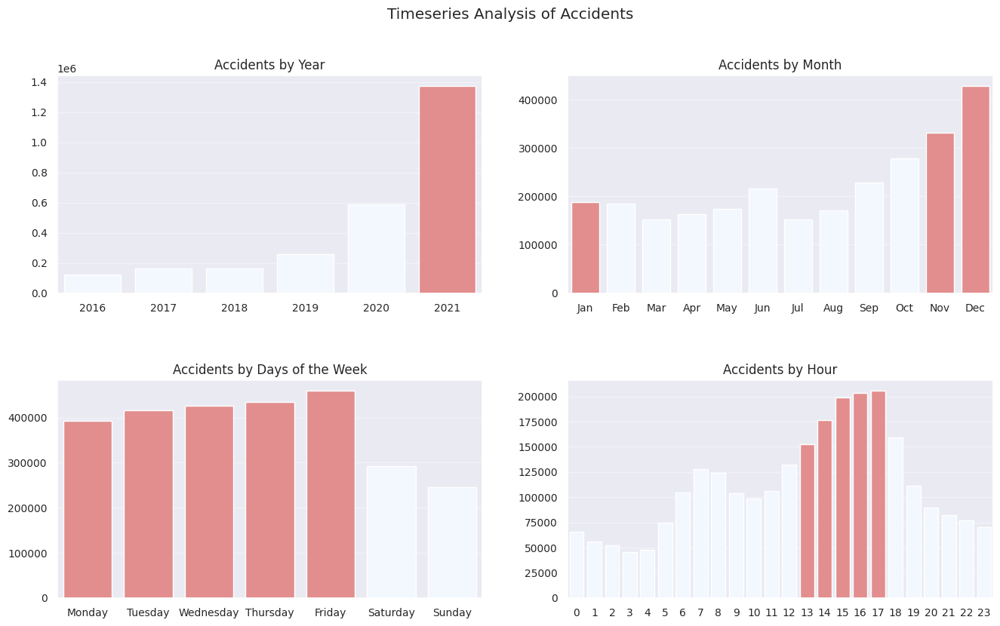

In [ ]:
year = df['year'].value_counts()
month = df['month'].value_counts().sort_index()

month_map = {1:'Jan' , 2:'Feb' , 3:'Mar' , 4:'Apr' , 5:'May' , 6:'Jun', 7:'Jul' , 8:'Aug', 9:'Sep',10:'Oct' , 11:'Nov' , 12:'Dec'}

hour = df['Hour'].value_counts().sort_index()
hour_severity = df[['Hour' , 'Severity']].groupby('Hour').agg({'Hour':'count', 'Severity' : 'mean'})

daily_accidents = df['Weekday'].value_counts().sort_index()
day_map = {0:'Monday' , 1:'Tuesday' , 2:'Wednesday' , 3:"Thursday" , 4:'Friday' , 5:"Saturday" , 6:'Sunday'}
year_map = {x:x for x in year.index}
hour_map = {x:x for x in hour.index}

light_palette = sns.color_palette(palette='pastel')


fig,([ax1,ax2],[ax3,ax4]) = plt.subplots(2,2,figsize=(16,9))

def plot_dist(kind, text, axis, LightCoral, skyblue):
    if kind == 'd':
        tot, ser, map = 7, daily_accidents, day_map
    elif kind == 'm':
        tot, ser, map = 12, month ,  month_map
    elif kind == 'y':
        tot, ser, map = 8, year ,  year_map
    elif kind == 'h':
        tot, ser, map = 24, hour ,  hour_map

    day_color_map = ['AliceBlue' for _ in range(tot)]
    for l in LightCoral:
        day_color_map[l] = 'LightCoral'
    for s in skyblue:
        day_color_map[s] = 'skyblue'

    sns.barplot(x=ser.index.map(map) , y=ser, ax = axis, palette = day_color_map)
    axis.set_xlabel(None)
    axis.set_ylabel(None)
    axis.set_title(f'Accidents by {text}')
    axis.grid(axis='y', linestyle='-', alpha=0.4)

plt.subplots_adjust(wspace=0.2 , hspace = 0.4)
plt.suptitle("Timeseries Analysis of Accidents" , )

plot_dist('d' ,"Days of the Week", ax3,[0, 1, 2, 3, 4],[])
plot_dist('y' ,"Year", ax1,[5,6],[])
plot_dist('m' ,"Month", ax2, [0, 10, 11],[])
plot_dist('h' ,"Hour", ax4,LightCoral=[13,14,15,16,17],skyblue=[])
plt.show()


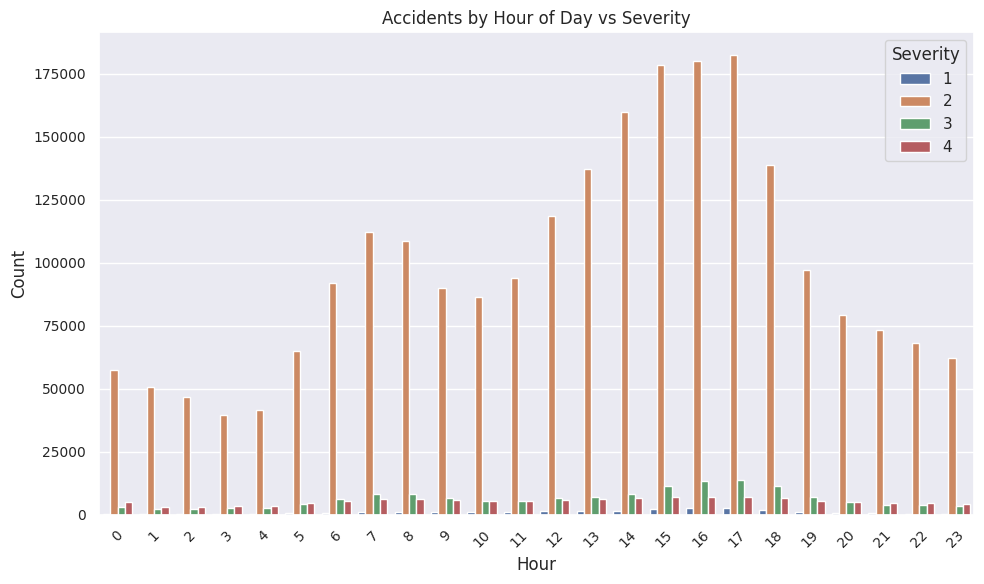

In [ ]:
severity_hour_dataset = df[['Severity', 'Hour']].copy()

plt.figure(figsize=(10, 6))
sns.countplot(data=severity_hour_dataset, x='Hour', hue='Severity')
plt.title('Accidents by Hour of Day vs Severity')
plt.xlabel('Hour')
plt.ylabel('Count')
plt.legend(title='Severity')
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

**Key Discoveries:**
1. Most of the accidents had taken place in the month of December followed by November and January. This could be due to US holidays(like Christmas, Thanksgiving etc) where most people travel.
2. Accidents are seen mostly in the weekdays. This could be due to the fact that most people drive to work.
3. To support above point, most of the accidents happen while commuting to work and back home.

In [ ]:
df.columns

Index(['Severity', 'Start_Lat', 'Start_Lng', 'Street', 'Side', 'City',
       'County', 'State', 'Zipcode', 'Airport_Code', 'Temperature(F)',
       'Wind_Chill(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)',
       'Wind_Direction', 'Wind_Speed(mph)', 'Precipitation(in)',
       'Weather_Condition', 'Amenity', 'Bump', 'Crossing', 'Give_Way',
       'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 'Stop',
       'Traffic_Calming', 'Traffic_Signal', 'Sunrise_Sunset_Night',
       'Civil_Twilight_Night', 'Nautical_Twilight_Night',
       'Astronomical_Twilight_Night', 'year', 'month', 'Weekday', 'Hour'],
      dtype='object')

#### **Analysis wrt Windspeed(mph), Percipitation(in), Humidity(%), Temperature(F), Pressure(in) and Visibility(mi)**

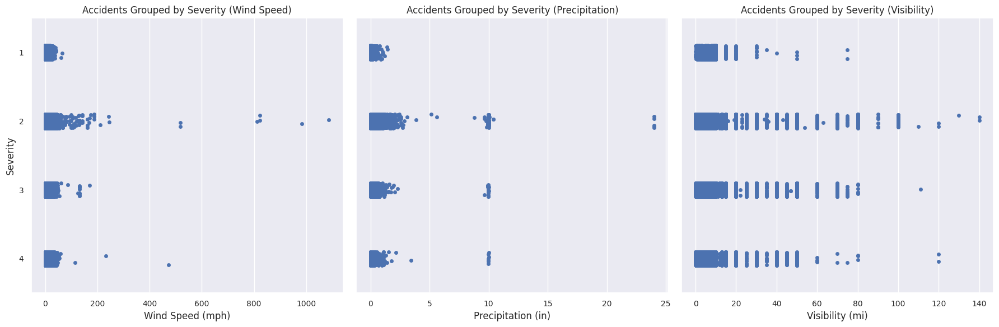

In [ ]:
df['Severity'] = df['Severity'].astype('category')

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6), sharey=True)

sns.stripplot(data=df, x='Wind_Speed(mph)', y='Severity', ax=axes[0])
axes[0].set_title('Accidents Grouped by Severity (Wind Speed)')
axes[0].set_xlabel('Wind Speed (mph)')
axes[0].set_ylabel('Severity')

sns.stripplot(data=df, x='Precipitation(in)', y='Severity', ax=axes[1])
axes[1].set_title('Accidents Grouped by Severity (Precipitation)')
axes[1].set_xlabel('Precipitation (in)')
axes[1].set_ylabel('Severity')

sns.stripplot(data=df, x='Visibility(mi)', y='Severity', ax=axes[2])
axes[2].set_title('Accidents Grouped by Severity (Visibility)')
axes[2].set_xlabel('Visibility (mi)')
axes[2].set_ylabel('Severity')

plt.tight_layout()
plt.show()

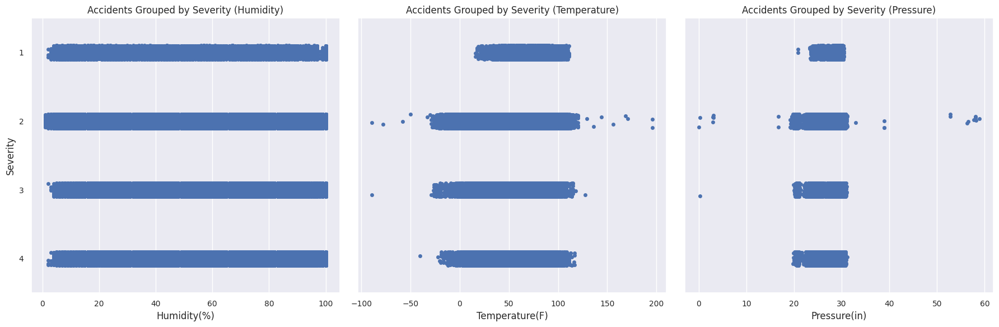

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6), sharey=True)

sns.stripplot(data=df, x='Humidity(%)', y='Severity', ax=axes[0])
axes[0].set_title('Accidents Grouped by Severity (Humidity)')
axes[0].set_xlabel('Humidity(%)')
axes[0].set_ylabel('Severity')

sns.stripplot(data=df, x='Temperature(F)', y='Severity', ax=axes[1])
axes[1].set_title('Accidents Grouped by Severity (Temperature)')
axes[1].set_xlabel('Temperature(F)')
axes[1].set_ylabel('Severity')

sns.stripplot(data=df, x='Pressure(in)', y='Severity', ax=axes[2])
axes[2].set_title('Accidents Grouped by Severity (Pressure)')
axes[2].set_xlabel('Pressure(in)')
axes[2].set_ylabel('Severity')

plt.tight_layout()
plt.show()

## **Tableau Interactive Dashboard**
It can be accessed from <a href="https://drive.google.com/file/d/1RA09mujfw-nS_brap35KUF0Ld1O74Ngi/view?usp=sharing">here</a>.

**Usage Instructions:**

1. Click on a specific state to filter and view relevant data.
2. Select a time zone to narrow down information based on the chosen time zone.
3. Choose a severity level by clicking on it to focus on incidents of that severity.
4. Click on a weather condition to filter data and see details related to that specific weather.

By interacting with these clickable elements, the system will dynamically adjust and display filtered values, providing users with a tailored and focused view based on their selections.

In [ ]:
%%html
<div class='tableauPlaceholder' id='viz1702027309901' style='position: relative'><noscript><a href='#'><img alt='Crash Insights: Analyzing Car Accidents and Predicting Accident Severity in the US ' src='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;US&#47;USAccidentDashboard2016-2021&#47;Dashboard1&#47;1_rss.png' style='border: none' /></a></noscript><object class='tableauViz'  style='display:none;'><param name='host_url' value='https%3A%2F%2Fpublic.tableau.com%2F' /> <param name='embed_code_version' value='3' /> <param name='site_root' value='' /><param name='name' value='USAccidentDashboard2016-2021&#47;Dashboard1' /><param name='tabs' value='no' /><param name='toolbar' value='yes' /><param name='static_image' value='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;US&#47;USAccidentDashboard2016-2021&#47;Dashboard1&#47;1.png' /> <param name='animate_transition' value='yes' /><param name='display_static_image' value='yes' /><param name='display_spinner' value='yes' /><param name='display_overlay' value='yes' /><param name='display_count' value='yes' /><param name='language' value='en-US' /><param name='filter' value='publish=yes' /></object></div>                <script type='text/javascript'>                    var divElement = document.getElementById('viz1702027309901');                    var vizElement = divElement.getElementsByTagName('object')[0];                    if ( divElement.offsetWidth > 800 ) { vizElement.style.width='1000px';vizElement.style.height='827px';} else if ( divElement.offsetWidth > 500 ) { vizElement.style.width='1000px';vizElement.style.height='827px';} else { vizElement.style.width='100%';vizElement.style.height='2077px';}                     var scriptElement = document.createElement('script');                    scriptElement.src = 'https://public.tableau.com/javascripts/api/viz_v1.js';                    vizElement.parentNode.insertBefore(scriptElement, vizElement);                </script>

# Outlier Analysis and Treatment

In [ ]:
weather_features_and_target = [   # list of numerical weather features and the target variable that we want to explore (Severity)
    "Humidity(%)",
    "Temperature(F)",
    "Wind_Chill(F)",
    "Wind_Speed(mph)",
    "Pressure(in)",
    "Visibility(mi)",
    "Precipitation(in)",
    "Severity"]

In [ ]:
dfff=df.copy()
dfff_sample_11_1293 = dfff.sample(frac=.11, random_state=1293)
dfff_sample_011_1293 = dfff.sample(frac=.011, random_state=1293)
dfff_sample_11_11 = dfff.sample(frac=.11, random_state=11)
dfff_sample_11_11 = dfff.sample(frac=.011, random_state=11)

dfff_sample_05_73 = dfff.sample(frac=.05, random_state=73)

In [ ]:
dfff_sample_05_73.info()

In [ ]:
dfff_sample_11_1293.info()

In [ ]:
dfff_sample_011_1293.info()

In [ ]:
def IQR_single_column_filter(data: pd.DataFrame, scale=1.5) -> list:
    """
    Returns boolean filter, where "False" indicates a datapoint is not an outlier.
    Use filter out outliers from a column using the IQR method: df[IQR_single_column_filter(data, scale)]
    """

    Q1 = data.quantile(0.25)
    Q3 = data.quantile(0.75)

    IQR = Q3 - Q1

    lower_bound = Q1 - (scale*IQR)
    upper_bound = Q3 + (scale*IQR)

    return list(~((data < lower_bound) | (data > upper_bound)))
    # return list(~(data > upper_bound))

In [ ]:
def outlier_filter(data: pd.DataFrame, cols: list) -> pd.DataFrame:
    """
    Filter out outliers from a dataframe using IQR method.
    """
    if not cols:
        print(f"Dataframe shape: {data.shape}")
        return data
    else:
        print(f"Dataframe shape: {data.shape}")
        first_col = cols[0]
        filtered_data = data[IQR_single_column_filter(data[first_col], scale=1.7)]
        remaining_cols = cols[1:]

        return outlier_filter(filtered_data, remaining_cols)

In [ ]:
numerical_features_transformed2 = [
    "Humidity(%)",
    "Temperature(F)",
    "Wind_Chill(F)",
    "Wind_Speed(mph)",
    "Pressure(in)",
    "log2(x+1): Precipitation(in)",
    "log2(x): Visibility(mi)",
    "Severity"]

In [ ]:
columns_to_filter = ["Pressure(in)", "Wind_Speed(mph)"]

In [ ]:
dfff_transformed2_sample_05_73 = outlier_filter(dfff_sample_05_73, cols=columns_to_filter)

dfff_transformed2_sample_05_73["Precipitation(in)"] += 1  # apply x + 1

dfff_transformed2_sample_05_73["log2(x+1): Precipitation(in)"] = np.log2(dfff_transformed2_sample_05_73["Precipitation(in)"])
dfff_transformed2_sample_05_73["log2(x): Visibility(mi)"] = np.log2(dfff_transformed2_sample_05_73["Visibility(mi)"])  # only log(x) for visibility
dfff_transformed2_sample_05_73[["log2(x+1): Precipitation(in)", "log2(x): Visibility(mi)"]]

Dataframe shape: (133328, 39)
Dataframe shape: (124791, 39)
Dataframe shape: (121781, 39)


,log2(x+1): Precipitation(in),log2(x): Visibility(mi)
2373776,0.0,3.321928
2294472,0.0,3.321928
1356613,0.0,3.321928
2568850,0.0,3.321928
39588,0.0,3.321928
...,...,...
539395,0.0,2.807355
320991,0.0,3.321928
1517702,0.0,3.321928
927056,0.0,2.000000


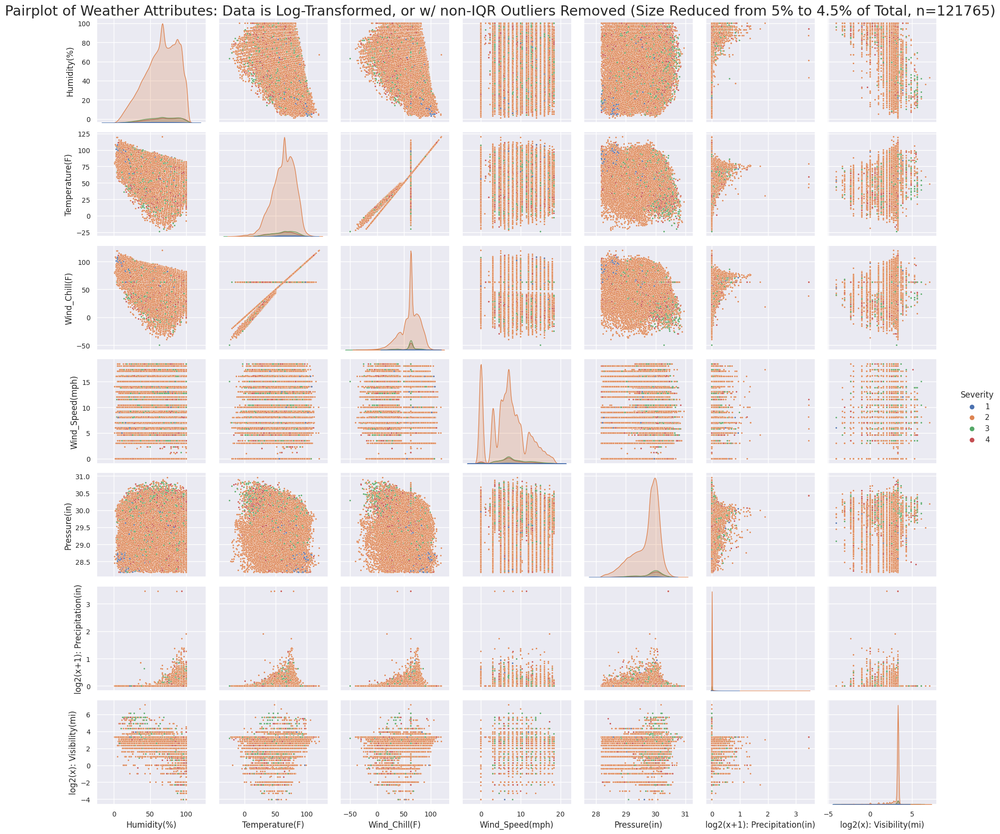

In [ ]:
sns.pairplot(dfff_transformed2_sample_05_73[numerical_features_transformed2],
            hue='Severity',
            plot_kws={"s": 6}
            ).fig.suptitle('Pairplot of Weather Attributes: Data is Log-Transformed, or w/ non-IQR Outliers Removed (Size Reduced from 5% to 4.5% of Total, n=121765)',
                             fontsize='xx-large')
plt.tight_layout()

plt.show()

In [ ]:
fig = px.parallel_coordinates(
    dfff_transformed2_sample_05_73[numerical_features_transformed2],
    color="Severity",
    labels={
        "Humidity(%)": "Humidity",
        "Temperature(F)": "Temperature",
        "Wind_Chill(F)": "Wind_Chill",
        "Pressure(in)": "Pressure",
        "log2(x): Visibility(mi)": "log(x): Visibility",
        "Wind_Speed(mph)": "Wind_Speed",
        "log2(x+1): Precipitation(in)": "log(x+1): Precipitation"
    },
    color_continuous_scale=px.colors.diverging.Tealrose,
    color_continuous_midpoint=2,
    title="Parallel Coordinates Plot of Weather Attributes by Severity (Using 5% Random Sample Size; n=121765; random_state=73)"
)

fig.show()